# SPICY Catalog - cross-match with ALMA-IMF

https://ui.adsabs.harvard.edu/abs/2020arXiv201112961K/abstract

## Part 1: Find which SPICY sources are in ALMA-IMF

In [1]:
from astropy.io import fits
from astropy.table import Table

In [2]:
tbl = Table.read('https://sites.astro.caltech.edu/~mkuhn/SPICY/table1.fits')

In [3]:
tbl

SPICY,ra,dec,l,b,p1,p2,p3,class,silicate,pah,alpha,alpha_8,alpha_24,alpha_w4,env,group,var,nr,r,sigmar,skewnessr,Spitzer,mag3_6,e_mag3_6,mag4_5,e_mag4_5,mag5_8,e_mag5_8,mag8_0,e_mag8_0,csf,m3_6,m4_5,m5_8,m8_0,2MASS,UKIDSS,VIRAC,GaiaDR2,MIPS,AllWISE,ZTFDR3
,deg,deg,deg,deg,,,,,,,,,,,,,,,,,,,mag,mag,mag,mag,mag,mag,mag,mag,,,,,,,,,,,,
int64,float64,float64,float64,float64,float32,float32,float32,bytes9,bool,bool,float64,float64,float64,float64,bytes7,bytes10,int16,int16,float64,float64,float64,bytes26,float32,float32,float32,float32,float32,float32,float32,float32,int32,int32,int32,int32,int32,bytes18,bytes19,int32,int64,bytes18,bytes20,int64
1,125.664811,-37.551349,255.975183,-0.253369,0.71,--,--,ClassII,False,False,-1.51695368300395,-1.51695368300395,--,--,EnvI,,--,--,--,--,--,SSTVELC G255.9751-00.2533,13.158,0.063,12.8,0.104,12.47,0.153,12.009,0.083,0,2,2,2,2,08223956-3733048,,--,5541983493883598976,,J082239.55-373304.5,--
2,125.795513,-37.585,256.06207,-0.187675,0.69,--,--,ClassII,False,False,-0.643206342197073,-0.643206342197073,--,--,EnvI,,--,--,--,--,--,SSTVELC G256.0620-00.1876,13.18,0.059,12.727,0.097,12.241,0.12,11.404,0.059,0,2,2,2,2,08231092-3735060,,--,5541980848188474496,,J082310.90-373505.9,--
3,125.860244,-37.577463,256.085297,-0.141319,0.87,--,--,FS,False,False,-0.00214090416881411,-0.153776440767654,--,-0.00214090416881411,EnvI,,--,--,--,--,--,SSTVELC G256.0853-00.1413,11.703,0.052,11.197,0.061,10.674,0.059,9.576,0.034,0,2,2,2,2,08232646-3734388,,--,5541969475116705664,,J082326.45-373438.8,--
4,125.946863,-37.770809,256.282985,-0.196119,0.53,--,--,ClassI,False,False,0.337295842881326,0.337295842881326,--,--,EnvI,,--,--,--,--,--,SSTVELC G256.2829-00.1961,14.271,0.096,13.398,0.084,12.462,0.142,11.478,0.045,0,2,4,2,4,,,--,--,,J082347.25-374615.0,--
5,126.003155,-37.126075,255.780917,0.210831,0.54,--,--,FS,False,False,-0.278597489454348,-0.278597489454348,--,--,EnvI,,--,--,--,--,--,SSTVELC G255.7809+00.2108,13.198,0.065,12.393,0.084,11.726,0.077,10.848,0.048,0,2,2,2,2,08240071-3707341,,--,5542020537982099840,,J082400.75-370733.7,--
6,126.1733,-38.104664,256.658808,-0.242061,0.73,--,--,ClassII,False,False,-0.731894982053407,-0.731894982053407,--,--,EnvI,G257.2-0.0,--,--,--,--,--,SSTVELC G256.6588-00.2420,13.736,0.071,12.906,0.103,12.172,0.1,11.637,0.068,0,3,2,2,2,,,--,--,,J082441.57-380616.8,--
7,126.301474,-37.89513,256.545885,-0.038703,0.74,--,--,ClassII,False,False,-0.593934875610214,-0.593934875610214,--,--,EnvI,G257.2-0.0,--,--,--,--,--,SSTVELC G256.5458-00.0387,11.838,0.054,11.268,0.062,10.705,0.059,9.915,0.052,0,2,2,2,2,08251235-3753424,,--,5541764656715605632,,J082512.35-375342.2,--
8,126.307182,-38.226459,256.819016,-0.226317,0.66,--,--,FS,False,False,0.225613851951121,0.225613851951121,--,--,EnvI,G257.2-0.0,--,--,--,--,--,SSTVELC G256.8190-00.2263,13.245,0.076,12.431,0.096,11.651,0.12,10.579,0.051,0,2,2,2,2,08251369-3813351,,--,5541703427661554560,,J082513.74-381335.5,--


In [4]:
from astropy.coordinates import SkyCoord
from astropy import units as u
coords = SkyCoord(tbl['l'], tbl['b'], frame='galactic', unit=(u.deg, u.deg))
coords

<SkyCoord (Galactic): (l, b) in deg
    [(255.975183, -0.253369), (256.06207 , -0.187675),
     (256.085297, -0.141319), ..., (110.208963,  0.115081),
     (110.214168,  0.113614), (110.21706 ,  0.104861)]>

In [5]:
import sys
sys.path.append('/orange/adamginsburg/ALMA_IMF/reduction/analysis/')
from spectralindex import prefixes

In [6]:
from spectral_cube import SpectralCube

In [7]:
import os
os.chdir('/orange/adamginsburg/ALMA_IMF/2017.1.01355.L/RestructuredImagingResults')

prefixes['W43MM1'] = dict(
    finaliter_prefix_b3="W43-MM1/B3/cleanest/W43-MM1_B3_uid___A001_X1296_X1af_continuum_merged_12M_robust0_selfcal4_finaliter",
    finaliter_prefix_b6="W43-MM2/B6/cleanest/W43-MM2_B6_uid___A001_X1296_X113_continuum_merged_12M_robust0_selfcal5_finaliter",)

for fieldid, pfxs in prefixes.items():
    cube = SpectralCube.read(pfxs['finaliter_prefix_b3']+".image.tt0.fits", format='fits', use_dask=False).minimal_subcube()
    ww = cube.wcs.celestial
    ww._naxis = cube.shape[1:]
    matches = ww.footprint_contains(coords)
    print(f"{fieldid}: {matches.sum()}")

G328: 17
G333: 2
G12: 11
W51IRS2: 4
G008: 13
G327: 6
G10: 8
G337: 10
G338: 5
G351: 21
G353: 11
W43MM3: 6
W43MM2: 6
W51-E: 2
W43MM1: 2


In [8]:
for fieldid, pfxs in prefixes.items():
    cube = SpectralCube.read(pfxs['finaliter_prefix_b3']+".image.tt0.fits", format='fits', use_dask=False).minimal_subcube()
    ww = cube.wcs.celestial
    ww._naxis = cube.shape[1:]
    matches = ww.footprint_contains(coords)
    print(f"{fieldid}: {matches.sum()}")
    print(tbl[matches][['SPICY','p1','class','UKIDSS','VIRAC']])
    print()

G328: 17
SPICY  p1    class          UKIDSS         VIRAC  
----- ---- --------- ------------------- ---------
31362   -- uncertain                     336878763
31366 0.71 FS                            336878800
31367 0.76 FS                            336993608
31389 0.66 ClassII                       336879047
31390   -- uncertain                     336879062
31395 0.91 FS                                   --
31405   -- uncertain                     336879094
31415  0.9 ClassI                        337085859
31420 0.84 ClassII                              --
31423 0.56 ClassI                        337085862
31431 0.87 ClassI                        337085901
31432  0.8 uncertain                            --
31438 0.82 FS                                   --
31441   -- uncertain                     337036104
31444   -- uncertain                     337036046
31453 0.55 ClassI                        337286988
31463 0.55 uncertain                            --

G333: 2
SPICY  p1    

# Show the sources on the ALMA-IMF cutouts

In [12]:
import sys
sys.path.append('/orange/adamginsburg/ALMA_IMF/reduction/analysis')

In [13]:
import spitzer_plots
from spitzer_plots import show_fov_on_spitzer, contour_levels
from spectralindex import prefixes
from spectral_cube import SpectralCube

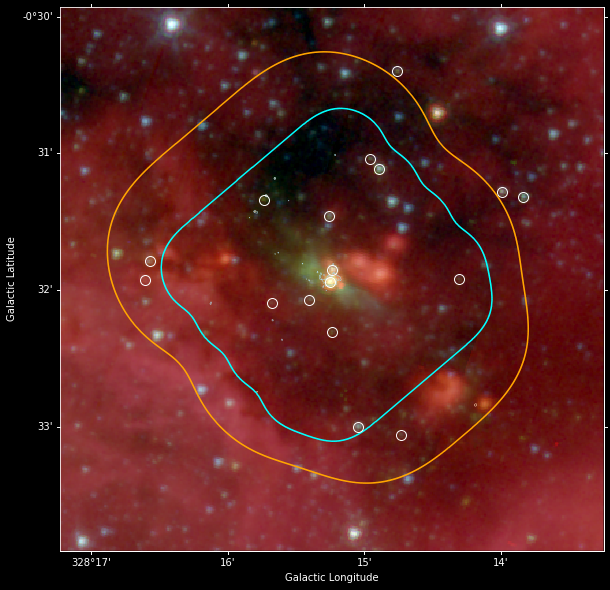

In [14]:
fieldid = 'G328'
basepath = '/orange/adamginsburg/ALMA_IMF/2017.1.01355.L/RestructuredImagingResults'
pfxs = prefixes[fieldid]
fig = show_fov_on_spitzer(**{key: f'{basepath}/{val}' for key,val in pfxs.items()},
                          fieldid=fieldid, spitzerpath=f'{basepath}/spitzer_datapath',
                          contour_level=contour_levels[fieldid])


cube = SpectralCube.read(basepath + '/' + pfxs['finaliter_prefix_b3']+".image.tt0.fits",
                         format='fits', use_dask=False).minimal_subcube()
ww = cube.wcs.celestial
ww._naxis = cube.shape[1:]
matches = ww.footprint_contains(coords)

cc = coords[matches]

ax = fig.gca()
ax.plot(cc.fk5.ra.deg, cc.fk5.dec.deg, 'wo', mfc='none', mec='w', markersize=10, transform=ax.get_transform('fk5'), )

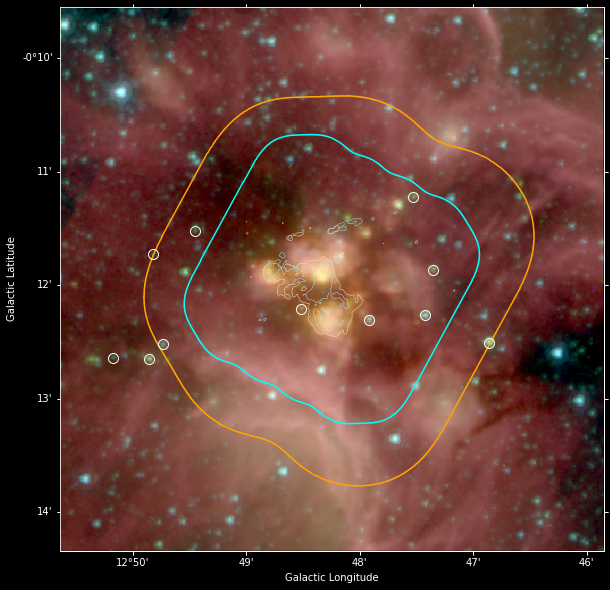

In [15]:
fieldid = 'G12'
basepath = '/orange/adamginsburg/ALMA_IMF/2017.1.01355.L/RestructuredImagingResults'
pfxs = prefixes[fieldid]
fig = show_fov_on_spitzer(**{key: f'{basepath}/{val}' for key,val in pfxs.items()},
                          fieldid=fieldid, spitzerpath=f'{basepath}/spitzer_datapath',
                          contour_level=contour_levels[fieldid])


cube = SpectralCube.read(basepath + '/' + pfxs['finaliter_prefix_b3']+".image.tt0.fits",
                         format='fits', use_dask=False).minimal_subcube()
ww = cube.wcs.celestial
ww._naxis = cube.shape[1:]
matches = ww.footprint_contains(coords)

cc = coords[matches]

ax = fig.gca()
ax.plot(cc.fk5.ra.deg, cc.fk5.dec.deg, 'wo', mfc='none', mec='w', markersize=10, transform=ax.get_transform('fk5'), )

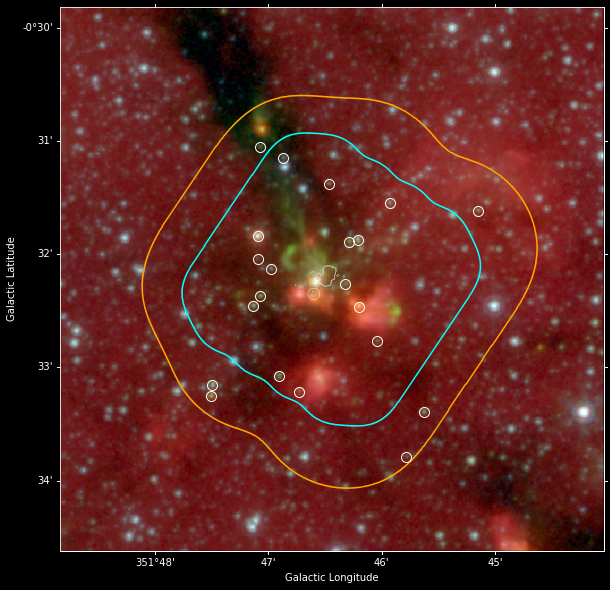

In [16]:
fieldid = 'G351'
basepath = '/orange/adamginsburg/ALMA_IMF/2017.1.01355.L/RestructuredImagingResults'
pfxs = prefixes[fieldid]
fig = show_fov_on_spitzer(**{key: f'{basepath}/{val}' for key,val in pfxs.items()},
                          fieldid=fieldid, spitzerpath=f'{basepath}/spitzer_datapath',
                          contour_level=contour_levels[fieldid])


cube = SpectralCube.read(basepath + '/' + pfxs['finaliter_prefix_b3']+".image.tt0.fits",
                         format='fits', use_dask=False).minimal_subcube()
ww = cube.wcs.celestial
ww._naxis = cube.shape[1:]
matches = ww.footprint_contains(coords)

cc = coords[matches]

ax = fig.gca()
ax.plot(cc.fk5.ra.deg, cc.fk5.dec.deg, 'wo', mfc='none', mec='w', markersize=10, transform=ax.get_transform('fk5'), )

In [17]:
tbl[matches].show_in_notebook()

idx,SPICY,ra,dec,l,b,p1,p2,p3,class,silicate,pah,alpha,alpha_8,alpha_24,alpha_w4,env,group,var,nr,r,sigmar,skewnessr,Spitzer,mag3_6,e_mag3_6,mag4_5,e_mag4_5,mag5_8,e_mag5_8,mag8_0,e_mag8_0,csf,m3_6,m4_5,m5_8,m8_0,2MASS,UKIDSS,VIRAC,GaiaDR2,MIPS,AllWISE,ZTFDR3
,,deg,deg,deg,deg,,,,,,,,,,,,,,,,,,,mag,mag,mag,mag,mag,mag,mag,mag,,,,,,,,,,,,
0,54167,261.652251,-36.167927,351.752496,-0.526919,--,--,0.91,uncertain,False,False,--,--,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7525-00.5269,12.524,0.063,11.579,0.072,10.881,0.114,--,--,0,3,3,2,0,,,190355725,--,,,--
1,54182,261.660092,-36.15651,351.765503,-0.5258,0.77,--,--,ClassII,False,False,-0.656345399953561,-0.656345399953561,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7655-00.5258,11.834,0.06,11.521,0.147,10.886,0.067,10.206,0.178,0,3,3,3,1,17263841-3609233,,--,--,,,--
2,54188,261.663333,-36.147512,351.774431,-0.52295,--,--,0.88,ClassII,False,False,-0.837007444105362,-0.837007444105362,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7744-00.5229,13.022,0.063,12.044,0.078,11.329,0.087,10.839,0.113,2,3,3,3,3,,,190656901,--,,,--
3,54189,261.664128,-36.139826,351.781167,-0.519194,0.55,--,0.83,FS,False,False,0.0137465456276494,0.0137465456276494,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7811-00.5191,12.898,0.062,12.639,0.089,11.97,0.121,10.916,0.06,0,3,3,3,3,,,190657337,--,,,--
4,54192,261.664785,-36.136122,351.784537,-0.517567,0.65,--,--,ClassII,False,False,-0.447762858069217,-0.447762858069217,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7845-00.5175,14.447,0.092,12.995,0.084,12.283,0.138,11.553,0.166,0,3,3,2,1,,,--,--,,,--
5,54197,261.668901,-36.15563,351.770203,-0.531211,0.82,--,0.77,ClassII,False,False,-1.47096698085622,-1.47096698085622,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7702-00.5312,11.105,0.046,10.03,0.053,9.619,0.045,9.211,0.049,0,3,2,4,3,17264052-3609201,,190656688,--,,,--
6,54200,261.670034,-36.154776,351.771422,-0.531494,0.84,--,--,uncertain,True,False,-1.79944342476858,-1.79944342476858,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7714-00.5314,12.955,0.063,11.407,0.073,10.604,0.057,10.788,0.146,0,3,3,4,2,,,--,--,,,--
7,54207,261.676801,-36.157759,351.771995,-0.537692,--,--,0.57,uncertain,False,False,--,--,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7720-00.5376,13.054,0.075,11.859,0.154,--,--,--,--,0,3,2,0,0,,,191219648,--,,,--
8,54212,261.678557,-36.143122,351.784934,-0.530703,0.54,--,0.74,FS,False,False,-0.209617436232755,-0.209617436232755,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7849-00.5307,9.22,0.039,8.273,0.045,7.478,0.024,6.686,0.022,0,3,3,3,3,17264284-3608351,,190657501,--,,J172642.84-360835.0,--


In [18]:
from astroquery.vizier import Vizier
from astroquery.svo_fps import SvoFps

In [19]:
from astropy import table

# Obtain VVV "VIRAC" YZJHK magnitudes to go along with the Spitzer magnitudes

This grabs the rows of the VIRAC table matched in SPICY and merges them.

In [20]:
thistbl = tbl[matches]
virac_numbers = thistbl['VIRAC']
virac_match = Vizier(row_limit=1000).query_constraints(srcid=",".join(map(str, virac_numbers[~virac_numbers.mask])),
                                                       catalog='II/364/virac')[0]
virac_match.rename_column('srcid','VIRAC')
sed_tbl = table.join(thistbl[~virac_numbers.mask], virac_match, join_type='left')
sed_tbl.show_in_notebook()

idx,SPICY,ra,dec,l,b,p1,p2,p3,class,silicate,pah,alpha,alpha_8,alpha_24,alpha_w4,env,group,var,nr,r,sigmar,skewnessr,Spitzer,mag3_6,e_mag3_6,mag4_5,e_mag4_5,mag5_8,e_mag5_8,mag8_0,e_mag8_0,csf,m3_6,m4_5,m5_8,m8_0,2MASS,UKIDSS,VIRAC,GaiaDR2,MIPS,AllWISE,ZTFDR3,RA_ICRS,DE_ICRS,Ksmag,KsEll,pm,e_pm,pmRA,e_pmRA,pmDE,e_pmDE,Nep,flgrel,Zmag,Zell,Ymag,Yell,Jmag,Jell,Hmag,Hell,Zdetflg,Ydetflg,Jdetflg,Hdetflg
,,deg,deg,deg,deg,,,,,,,,,,,,,,,,,,,mag,mag,mag,mag,mag,mag,mag,mag,,,,,,,,,,,,,deg,deg,mag,,mas / yr,mas / yr,mas / yr,mas / yr,mas / yr,mas / yr,,,mag,,mag,,mag,,mag,,,,,
0,54167,261.652251,-36.167927,351.752496,-0.526919,--,--,0.91,uncertain,False,False,--,--,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7525-00.5269,12.524,0.063,11.579,0.072,10.881,0.114,--,--,0,3,3,2,0,,,190355725,--,,,--,261.652233,-36.167941,16.995,0.1,8.23,8.52,2.25,8.82,7.913,8.492,12,0,--,--,--,--,--,--,--,--,1,1,1,1
1,54233,261.688301,-36.17784,351.760508,-0.5566,0.86,--,0.71,ClassII,False,False,-0.682623515466555,-0.682623515466555,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7605-00.5566,12.524,0.054,11.513,0.063,10.817,0.059,10.214,0.043,0,3,3,3,3,,,190656102,--,,,--,261.688254,-36.177813,15.061,0.1,4.43,1.42,-1.22,1.36,4.263,1.420,139,1,--,--,--,--,--,--,17.536,0.1965,1,1,1,0
2,54251,261.696805,-36.17938,351.763059,-0.563156,0.69,--,0.13,ClassII,False,False,-0.349219924895509,-0.349219924895509,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7630-00.5631,13.106,0.069,12.563,0.095,11.926,0.134,11.061,0.083,0,3,3,2,3,,,190656270,--,,,--,261.696747,-36.179363,14.504,0.2,4.51,2.10,3.54,2.04,-2.801,2.191,139,1,--,--,--,--,17.394,0.1273,15.478,0.4308,1,1,0,0
3,54224,261.682255,-36.166349,351.767322,-0.546139,--,--,0.76,uncertain,False,False,--,--,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7673-00.5461,13.482,0.087,12.394,0.107,11.732,0.203,--,--,0,3,3,2,0,,,190656529,--,,,--,261.682361,-36.166375,15.923,0.4,8.94,5.39,4.41,5.12,7.780,5.480,137,0,19.851,0.1688,18.988,0.1749,18.023,0.1412,16.944,0.2842,0,0,0,0
4,54197,261.668901,-36.15563,351.770203,-0.531211,0.82,--,0.77,ClassII,False,False,-1.47096698085622,-1.47096698085622,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7702-00.5312,11.105,0.046,10.03,0.053,9.619,0.045,9.211,0.049,0,3,2,4,3,17264052-3609201,,190656688,--,,,--,261.668858,-36.155573,13.108,0.2,2.31,0.74,0.98,0.82,2.090,0.727,140,1,--,--,--,--,--,--,15.581,0.1215,1,1,1,0
5,54188,261.663333,-36.147512,351.774431,-0.52295,--,--,0.88,ClassII,False,False,-0.837007444105362,-0.837007444105362,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7744-00.5229,13.022,0.063,12.044,0.078,11.329,0.087,10.839,0.113,2,3,3,3,3,,,190656901,--,,,--,261.663338,-36.147496,16.532,0.2,3.52,5.29,-3.43,5.30,0.801,5.145,91,0,--,--,--,--,--,--,--,--,1,1,1,1
6,54255,261.697831,-36.160975,351.778798,-0.553578,--,--,0.92,uncertain,False,False,--,--,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7788-00.5535,13.443,0.127,12.322,0.095,--,--,--,--,0,3,3,0,0,,,190657174,--,,,--,261.697788,-36.160966,16.226,0.2,7.41,3.32,4.04,3.47,-6.210,3.255,128,0,--,--,--,--,--,--,17.643,0.0610,1,1,1,0
7,54189,261.664128,-36.139826,351.781167,-0.519194,0.55,--,0.83,FS,False,False,0.0137465456276494,0.0137465456276494,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7811-00.5191,12.898,0.062,12.639,0.089,11.97,0.121,10.916,0.06,0,3,3,3,3,,,190657337,--,,,--,261.664103,-36.139796,14.145,0.1,2.02,1.43,-0.85,1.54,1.829,1.405,140,1,--,--,--,--,--,--,15.206,0.2223,1,1,1,0
8,54212,261.678557,-36.143122,351.784934,-0.530703,0.54,--,0.74,FS,False,False,-0.209617436232755,-0.209617436232755,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7849-00.5307,9.22,0.039,8.273,0.045,7.478,0.024,6.686,0.022,0,3,3,3,3,17264284-3608351,,190657501,--,,J172642.84-360835.0,--,261.678532,-36.143090,11.827,0.1,1.59,0.81,0.89,0.77,1.320,0.822,140,1,--,--,--,--,--,--,14.991,0.1431,1,1,1,0


In [22]:
# hacky function to extract the rows of an SED table as a plottable entry

row(tb, rownum, keys=['Ymag', 'Zmag', 'Jmag', 'Hmag', 'Ksmag','mag3_6', 'mag4_5', 'mag5_8', 'mag8_0',]):
    return np.array([tb[rownum][key] for key in keys])

In [23]:
magcols = ['Ymag', 'Zmag', 'Jmag', 'Hmag', 'Ksmag','mag3_6', 'mag4_5', 'mag5_8', 'mag8_0',]
emagcols = ['Yell', 'Zell', 'Jell', 'Hell', 'KsEll','e_mag3_6', 'e_mag4_5', 'e_mag5_8', 'e_mag8_0',]

# these are the official filternames on SVO_FPS
filternames = ['Paranal/VISTA.Y', 'Paranal/VISTA.Z', 'Paranal/VISTA.J', 'Paranal/VISTA.H', 'Paranal/VISTA.Ks',
               'Spitzer/IRAC.I1', 'Spitzer/IRAC.I2', 'Spitzer/IRAC.I3', 'Spitzer/IRAC.I4']
filter_meta = table.vstack([SvoFps.get_filter_list(facility='Paranal', instrument='VIRCAM'),
                            SvoFps.get_filter_list(facility='Spitzer', instrument='IRAC')])
zpts = {filtername: filter_meta[filter_meta['filterID']==filtername]['ZeroPoint'] for filtername in filternames}
wavelengths = [np.average(SvoFps.get_transmission_data(filtername)['Wavelength'],
                          weights=SvoFps.get_transmission_data(filtername)['Transmission'])
              for filtername in filternames]

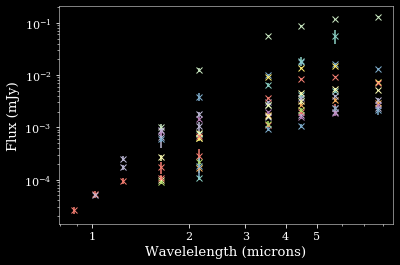

In [272]:
sed = sed_tbl[magcols]
esed = sed_tbl[emagcols]
zps = np.array([zpts[fn] for fn in filternames], dtype='float').squeeze()*u.Jy

for rownum in range(len(sed)):
    flx = zps.value * 10**(getrow(sed, rownum)/-2.5)
    err = getrow(esed, rownum, emagcols) / 1.09 * flx
    pl.errorbar(np.array(wavelengths)/1e4, flx, yerr=err, marker='x', linestyle='none')
_=pl.loglog()
_=pl.gca().set_xticks([1,2,3,4,5])
_=pl.gca().set_xticklabels([1,2,3,4,5])
_=pl.xlabel("Wavelelength (microns)")
_=pl.ylabel("Flux (mJy)")

# Follow docs to fit SEDs

https://sedfitter.readthedocs.io/en/stable/fitting.html

In [187]:
robitaille_modeldir = '/blue/adamginsburg/richardson.t/research/flux/robitaille_models/'

In [25]:
from sedfitter import fit, Fitter

In [184]:
# https://sedfitter.readthedocs.io/en/stable/convolution.html
from sedfitter.filter import Filter
from astroquery.svo_fps import SvoFps

# these are the official filternames on SVO_FPS
filternames = ['Paranal/VISTA.Y', 'Paranal/VISTA.Z', 'Paranal/VISTA.J', 'Paranal/VISTA.H', 'Paranal/VISTA.Ks',
               'Spitzer/IRAC.I1', 'Spitzer/IRAC.I2', 'Spitzer/IRAC.I3', 'Spitzer/IRAC.I4']
filtercurves = {filtername: SvoFps.get_transmission_data(filtername) for filtername in filternames}
wavelengths = [np.average(filtercurves[filtername]['Wavelength'],
                          weights=filtercurves[filtername]['Transmission'])
              for filtername in filternames]

filterfreqs = {filtername: u.Quantity(filtercurves[filtername]['Wavelength'], u.AA).to(u.Hz, u.spectral()) for filtername in filternames}
filtertrans = {filtername: np.array(filtercurves[filtername]['Transmission'])[np.argsort(filterfreqs[filtername])]
              for filtername in filternames}
filterfreqs = {filtername: np.sort(filterfreqs[filtername]) for filtername in filternames}

sed_filters = [Filter(name=filtername,
                      central_wavelength=wl*u.AA,
                      nu=filterfreqs[filtername],
                      response=filtertrans[filtername])
               for filtername, wl in zip(filternames, wavelengths)]

almaimf_bandends_1mm = [[216.10085679, 216.36181569],
                        [217.05104378, 217.31175857],
                        [219.90488464, 220.04866835],
                        [218.13102322, 218.39222624],
                        [219.51976276, 219.66379059],
                        [230.31532951, 230.81137113],
                        [231.06503709, 231.56181105],
                        [231.52507012, 233.42623749]]*u.GHz
nu_1mm = np.linspace(almaimf_bandends_1mm.min(), almaimf_bandends_1mm.max(), 5000)
response_1mm = np.zeros(nu_1mm.size, dtype='bool')
for start, stop in almaimf_bandends_1mm:
    response_1mm |= (nu_1mm > start) & (nu_1mm < stop)
sed_filters.append(Filter(name='ALMA-IMF_1mm',
                          central_wavelength=(228.15802*u.GHz).to(u.mm, u.spectral()),
                          nu=nu_1mm,
                          response=response_1mm.astype(float),
                         ))

for filterfunc in sed_filters:
    filterfunc.normalize()


almaimf_bandends_3mm = [[ 93.13410936,  93.25141259],
                        [ 91.75059068,  92.68755174],
                        [102.15273354, 103.0896946 ],
                        [104.55323851, 105.49019957]]*u.GHz
nu_3mm = np.linspace(almaimf_bandends_3mm.min(), almaimf_bandends_3mm.max(), 5000)
response_3mm = np.zeros(nu_3mm.size, dtype='bool')
for start, stop in almaimf_bandends_3mm:
    response_3mm |= (nu_3mm > start) & (nu_3mm < stop)
sed_filters.append(Filter(name='ALMA-IMF_3mm',
                          central_wavelength=(99.68314596*u.GHz).to(u.mm, u.spectral()),
                          nu=nu_3mm,
                          response=response_3mm.astype(float),
                         ))

In [ ]:
if not os.path.exists(f'{robitaille_modeldir}/s-pbhmi/convolved/Spitzer/IRAC.I1.fits'):
    from sedfitter.convolve import convolve_model_dir

    for model_dir in glob.glob(f'{robitaille_modeldir}/s*'):
        convolve_model_dir(model_dir, sed_filters)

In [274]:
-2.5 / np.log(10)

-1.0857362047581294

In [299]:
from astropy import units as u
from sedfitter.extinction import Extinction
from sedfitter.source import Source

# Define path to models
model_dir = f'{robitaille_modeldir}/s-ubhmi'


# make an extinction law
from dust_extinction.parameter_averages import F19

# https://arxiv.org/abs/0903.2057
# 1.34 is from memory
guyver2009_avtocol = (2.21e21 * u.cm**-2 * (1.34*u.Da)).to(u.g/u.cm**2)
ext_wav = np.sort((np.geomspace(0.301, 8.699, 1000)/u.um).to(u.um, u.spectral()))
ext_vals = ext.evaluate(ext_wav, Rv=3.1)
extinction = Extinction()
extinction.wav = ext_wav
extinction.chi = ext_vals / guyver2009_avtocol

# Define filters and apertures
#filters = ['2J', '2H', '2K', 'I1', 'I2', 'I3', 'I4']
#apertures = [3., 3., 3., 3., 3., 3., 3.] * u.arcsec
filters = filternames
apertures = ([3]*len(filternames))*u.arcsec


source = Source()
# wavelengths, getrow(sed, rownum), yerr=getrow(esed, rownum, emagcols),
rownum = 3
data = getrow(sed, rownum)
error = getrow(esed, rownum, emagcols)
valid = np.isfinite(data)
flx = (zps * 10**(data/-2.5)).to(u.mJy).value

#flx = flx[valid]
#error = error[valid]

source.valid = valid#[valid]
source.flux = flx    
source.error =  error / 1.09 * flx

fitter = Fitter(filter_names=np.array(filters),#[valid],
                apertures=apertures,#[valid],
                model_dir=model_dir,
                extinction_law=extinction,
                distance_range=[1.8,2.2]*u.kpc,
                av_range=[0,40],
               )


# Run the fitting
fitinfo = fitter.fit(source)

 ------------------------------------------------------------
  => Model parameters
 ------------------------------------------------------------

   Models              :  s-ubhmi
   Log[d] stepping     :  0.02
   Number of distances :  6

 ------------------------------------------------------------
  => Reading in convolved fluxes
 ------------------------------------------------------------

   Reading /blue/adamginsburg/richardson.t/research/flux/robitaille_models//s-ubhmi/convolved/Paranal/VISTA.Y.fits


   Reading /blue/adamginsburg/richardson.t/research/flux/robitaille_models//s-ubhmi/convolved/Paranal/VISTA.Z.fits
   Reading /blue/adamginsburg/richardson.t/research/flux/robitaille_models//s-ubhmi/convolved/Paranal/VISTA.J.fits
   Reading /blue/adamginsburg/richardson.t/research/flux/robitaille_models//s-ubhmi/convolved/Paranal/VISTA.H.fits
   Reading /blue/adamginsburg/richardson.t/research/flux/robitaille_models//s-ubhmi/convolved/Paranal/VISTA.Ks.fits
   Reading /blue/adamginsburg/richardson.t/research/flux/robitaille_models//s-ubhmi/convolved/Spitzer/IRAC.I1.fits
   Reading /blue/adamginsburg/richardson.t/research/flux/robitaille_models//s-ubhmi/convolved/Spitzer/IRAC.I2.fits
   Reading /blue/adamginsburg/richardson.t/research/flux/robitaille_models//s-ubhmi/convolved/Spitzer/IRAC.I3.fits
   Reading /blue/adamginsburg/richardson.t/research/flux/robitaille_models//s-ubhmi/convolved/Spitzer/IRAC.I4.fits


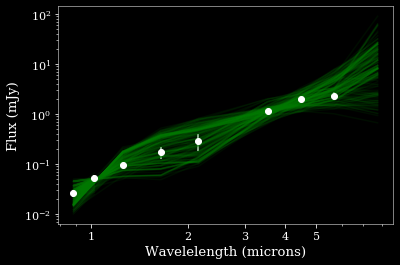

In [308]:
pl.errorbar(np.array(wavelengths)/1e4, source.flux, yerr=source.error, linestyle='none', color='w', marker='o')
_=pl.plot(np.array(wavelengths)/1e4, 10**fitinfo.model_fluxes[fitinfo.chi2 < np.nanmin(fitinfo.chi2) + 75,:].T, alpha=0.1, color='g')
_=pl.loglog()
_=pl.gca().set_xticks([1,2,3,4,5])
_=pl.gca().set_xticklabels([1,2,3,4,5])
_=pl.xlabel("Wavelelength (microns)")
_=pl.ylabel("Flux (mJy)")

In [301]:
fitinfo.model_id, fitinfo.model_fluxes, fitinfo.sc, fitinfo.chi2, fitinfo.filter_table, fitinfo.source, fitinfo.chi2.min()

(array([ 3257,  3256,  3255, ..., 37728, 37715, 89999]),
 <Quantity [[-1.30112004, -1.60935039, -0.97429419, ...,  0.24437034,
              0.41519488,  0.92315078],
            [-1.30275966, -1.63007401, -0.94990838, ...,  0.24211789,
              0.40160656,  0.91871544],
            [-1.30604616, -1.63577103, -0.94107252, ...,  0.25213662,
              0.40791523,  0.92702805],
            ...,
            [        nan,         nan,         nan, ...,         nan,
                     nan,         nan],
            [        nan,         nan,         nan, ...,         nan,
                     nan,         nan],
            [        nan,         nan,         nan, ...,         nan,
                     nan,         nan]]>,
 array([0.29013258, 0.30756261, 0.30756261, ..., 0.25527251, 0.25527251,
        0.25527251]),
 <Quantity [2.97288664, 4.09623801, 4.69856431, ...,        nan,        nan,
                   nan]>,
 <bound method FitInfo.filter_table of <sedfitter.fit_info.FitInfo

In [302]:
pars = Table.read('/blue/adamginsburg/richardson.t/research/flux/robitaille_models//s-pbhmi/parameters.fits')
pars = Table.read('/blue/adamginsburg/richardson.t/research/flux/pars/s-ubhmi_augmented.fits')

In [303]:
selection = fitinfo.chi2 < np.nanmin(fitinfo.chi2) + 25
pars[fitinfo.model_id[selection]].show_in_notebook()

idx,MODEL_NAME,star.radius,star.temperature,envelope.rho_0,envelope.rc,cavity.power,cavity.theta_0,cavity.rho_0,envelope.rmin,ambient.density,ambient.temperature,scattering,inclination,Model Luminosity,Envelope Mass [20],Envelope Weighted Temperature [20]
,,,,,,,,,,,,,,solLum,,
0,2F4fhd4V_09,0.4384,20460.0,7.849e-22,2734.0,1.141,48.75,4.6e-22,1.836,1e-23,10.0,1,86.38240544814074,30.342914037924185,1.2712259749586017e-07 .. 1.8208527394848266,244.88834887696004 .. 10.082207648723408
1,2F4fhd4V_08,0.4384,20460.0,7.849e-22,2734.0,1.141,48.75,4.6e-22,1.836,1e-23,10.0,1,71.09168720370413,30.342914037924185,1.2712259749586017e-07 .. 1.8208527394848266,244.88834887696004 .. 10.082207648723408
2,2F4fhd4V_07,0.4384,20460.0,7.849e-22,2734.0,1.141,48.75,4.6e-22,1.836,1e-23,10.0,1,61.383652911581635,30.342914037924185,1.2712259749586017e-07 .. 1.8208527394848266,244.88834887696004 .. 10.082207648723408
3,2F4fhd4V_01,0.4384,20460.0,7.849e-22,2734.0,1.141,48.75,4.6e-22,1.836,1e-23,10.0,1,6.997018959936398,30.342914037924185,1.2712259749586017e-07 .. 1.8208527394848266,244.88834887696004 .. 10.082207648723408
4,2F4fhd4V_02,0.4384,20460.0,7.849e-22,2734.0,1.141,48.75,4.6e-22,1.836,1e-23,10.0,1,19.264705016321216,30.342914037924185,1.2712259749586017e-07 .. 1.8208527394848266,244.88834887696004 .. 10.082207648723408
5,2F4fhd4V_03,0.4384,20460.0,7.849e-22,2734.0,1.141,48.75,4.6e-22,1.836,1e-23,10.0,1,29.073906307958467,30.342914037924185,1.2712259749586017e-07 .. 1.8208527394848266,244.88834887696004 .. 10.082207648723408
6,2F4fhd4V_04,0.4384,20460.0,7.849e-22,2734.0,1.141,48.75,4.6e-22,1.836,1e-23,10.0,1,37.55654402018593,30.342914037924185,1.2712259749586017e-07 .. 1.8208527394848266,244.88834887696004 .. 10.082207648723408
7,2F4fhd4V_05,0.4384,20460.0,7.849e-22,2734.0,1.141,48.75,4.6e-22,1.836,1e-23,10.0,1,45.808934262138195,30.342914037924185,1.2712259749586017e-07 .. 1.8208527394848266,244.88834887696004 .. 10.082207648723408
8,2F4fhd4V_06,0.4384,20460.0,7.849e-22,2734.0,1.141,48.75,4.6e-22,1.836,1e-23,10.0,1,54.285852897920314,30.342914037924185,1.2712259749586017e-07 .. 1.8208527394848266,244.88834887696004 .. 10.082207648723408


(array([28.,  1.,  3.,  1.,  2.,  1.,  0.,  0.,  1.,  1.]),
 array([ 0.1541 ,  1.25769,  2.36128,  3.46487,  4.56846,  5.67205,
         6.77564,  7.87923,  8.98282, 10.08641, 11.19   ]),
 <a list of 10 Patch objects>)

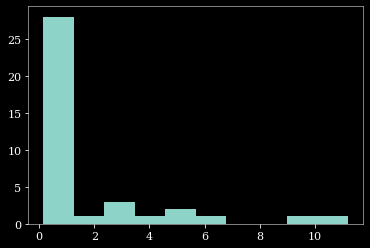

In [304]:
pl.hist(pars[fitinfo.model_id[selection]]['star.radius'])

(array([ 1.,  2.,  7.,  2.,  1.,  4., 14.,  1.,  5.,  1.]),
 array([ 2855. ,  5540.5,  8226. , 10911.5, 13597. , 16282.5, 18968. ,
        21653.5, 24339. , 27024.5, 29710. ]),
 <a list of 10 Patch objects>)

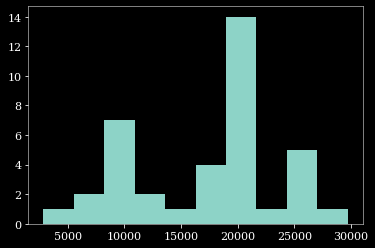

In [305]:
pl.hist(pars[fitinfo.model_id[selection]]['star.temperature'])

(array([35.,  0.,  0.,  2.,  0.,  0.,  0.,  0.,  0.,  1.]),
 array([   5.08480899,  207.05522341,  409.02563782,  610.99605224,
         812.96646665, 1014.93688107, 1216.90729548, 1418.8777099 ,
        1620.84812431, 1822.81853872, 2024.78895314]),
 <a list of 10 Patch objects>)

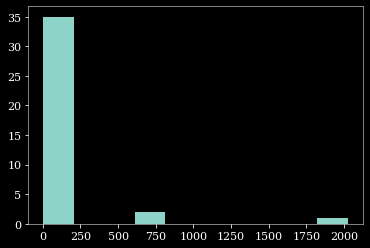

In [306]:
pl.hist(pars[fitinfo.model_id[selection]]['Model Luminosity'])

(array([12.,  0.,  1.,  0.,  0.,  0.,  0.,  1.,  0.,  6.]),
 array([1.27122597e-07, 1.82085388e-01, 3.64170650e-01, 5.46255911e-01,
        7.28341172e-01, 9.10426433e-01, 1.09251169e+00, 1.27459696e+00,
        1.45668222e+00, 1.63876748e+00, 1.82085274e+00]),
 <a list of 10 Patch objects>)

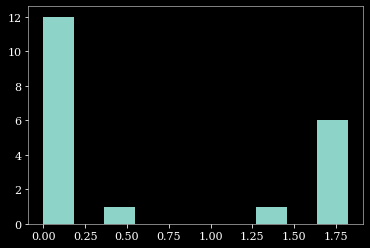

In [307]:
pl.hist(pars[fitinfo.model_id[selection]]['Envelope Mass'][5])

# Next Step: ALMA photometry


Aperture photometry in ALMA data to get 1mm, 3mm constraints

In [316]:
from astropy.visualization import simple_norm

In [324]:
pfxs['finaliter_prefix_b6']

'G351.77/B6/cleanest/G351.77_B6_uid___A001_X1296_X201_continuum_merged_12M_robust0_selfcal4_finaliter'

<Quantity 0.00048489 Jy / beam>

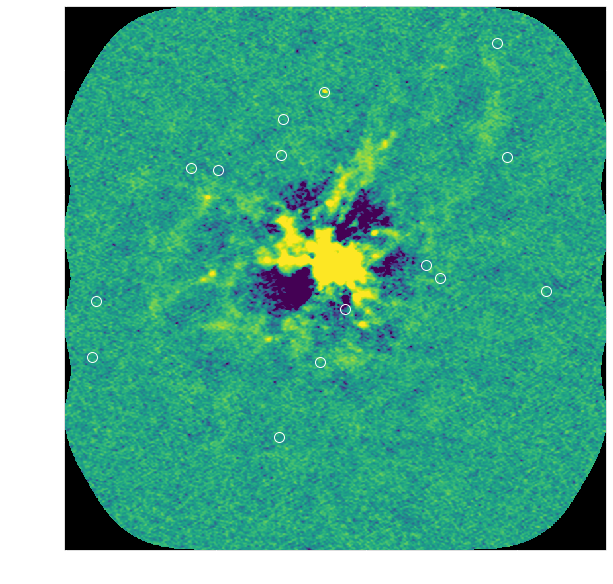

In [326]:
fieldid = 'G351'
basepath = '/orange/adamginsburg/ALMA_IMF/2017.1.01355.L/RestructuredImagingResults'
pfxs = prefixes[fieldid]

cube = SpectralCube.read(basepath + '/' + pfxs['finaliter_prefix_b6']+".image.tt0.fits",
                         format='fits', use_dask=False).minimal_subcube()
ww = cube.wcs.celestial
ww._naxis = cube.shape[1:]

fig = pl.figure(figsize=(10,10))
ax = fig.add_subplot(projection=ww)
ax.imshow(cube[0].value, norm=simple_norm(cube[0].value, max_percent=99., min_percent=1, stretch='asinh'))

matches = ww.footprint_contains(coords)

cc = coords[matches]

ax.plot(cc.fk5.ra.deg, cc.fk5.dec.deg, 'wo', mfc='none', mec='w', markersize=10, transform=ax.get_transform('fk5'), )

alma_1mm_rms = cube.mad_std()
alma_1mm_rms

# Compute ALMA photometry

In [327]:
import photutils

In [333]:
crds = SkyCoord(sed_tbl['ra'], sed_tbl['dec'])
sky_apertures = photutils.aperture.SkyCircularAperture(crds, 2*u.arcsec)
apertures = sky_apertures.to_pixel(ww)

sky_annulus_aperture = photutils.aperture.SkyCircularAnnulus(crds, r_in=3*u.arcsec, r_out=5*u.arcsec)
annulus_apertures = sky_annulus_aperture.to_pixel(ww)

In [334]:
from astropy.stats import sigma_clipped_stats

In [351]:
annulus_masks = annulus_apertures.to_mask(method='center')
data = cube[0]

bkg_median = []
for mask in annulus_masks:
    annulus_data = mask.multiply(data)
    if annulus_data is None:
        bkg_median.append(np.nan * data.unit)
        continue
    annulus_data_1d = annulus_data[mask.data != 0]
    _, median_sigclip, _ = sigma_clipped_stats(annulus_data_1d)
    bkg_median.append(median_sigclip)
bkg_median = u.Quantity(bkg_median)
phot = photutils.aperture_photometry(data, apertures)
phot['annulus_median'] = bkg_median
phot['aper_bkg'] = bkg_median * apertures.area
phot['aper_sum_bkgsub'] = phot['aperture_sum'] - phot['aper_bkg']
phot['flux'] = phot['aper_sum_bkgsub'] / cube.pixels_per_beam * u.beam
phot['significant'] = phot['flux'] > 3 * alma_1mm_rms*u.beam

In [358]:
sed_tbl['alma_1mm_flux'] = np.where(phot['significant'], phot['flux'], np.nan)

In [361]:
sed_tbl

SPICY,ra,dec,l,b,p1,p2,p3,class,silicate,pah,alpha,alpha_8,alpha_24,alpha_w4,env,group,var,nr,r,sigmar,skewnessr,Spitzer,mag3_6,e_mag3_6,mag4_5,e_mag4_5,mag5_8,e_mag5_8,mag8_0,e_mag8_0,csf,m3_6,m4_5,m5_8,m8_0,2MASS,UKIDSS,VIRAC,GaiaDR2,MIPS,AllWISE,ZTFDR3,RA_ICRS,DE_ICRS,Ksmag,KsEll,pm,e_pm,pmRA,e_pmRA,pmDE,e_pmDE,Nep,flgrel,Zmag,Zell,Ymag,Yell,Jmag,Jell,Hmag,Hell,Zdetflg,Ydetflg,Jdetflg,Hdetflg,alma_1mm_flux
,deg,deg,deg,deg,,,,,,,,,,,,,,,,,,,mag,mag,mag,mag,mag,mag,mag,mag,,,,,,,,,,,,,deg,deg,mag,,mas / yr,mas / yr,mas / yr,mas / yr,mas / yr,mas / yr,,,mag,,mag,,mag,,mag,,,,,,
int64,float64,float64,float64,float64,float32,float32,float32,bytes9,bool,bool,float64,float64,float64,float64,bytes7,bytes10,int16,int16,float64,float64,float64,bytes26,float32,float32,float32,float32,float32,float32,float32,float32,int32,int32,int32,int32,int32,bytes18,bytes19,int32,int64,bytes18,bytes20,int64,float64,float64,float32,float32,float64,float64,float64,float64,float64,float64,int16,uint8,float64,float32,float64,float32,float32,float32,float64,float32,uint8,uint8,uint8,uint8,float64
54167,261.652251,-36.167927,351.752496,-0.526919,--,--,0.91,uncertain,False,False,--,--,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7525-00.5269,12.524,0.063,11.579,0.072,10.881,0.114,--,--,0,3,3,2,0,,,190355725,--,,,--,261.652233,-36.167941,16.995,0.1,8.23,8.52,2.25,8.82,7.913,8.492,12,0,--,--,--,--,--,--,--,--,1,1,1,1,nan
54233,261.688301,-36.17784,351.760508,-0.5566,0.86,--,0.71,ClassII,False,False,-0.682623515466555,-0.682623515466555,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7605-00.5566,12.524,0.054,11.513,0.063,10.817,0.059,10.214,0.043,0,3,3,3,3,,,190656102,--,,,--,261.688254,-36.177813,15.061,0.1,4.43,1.42,-1.22,1.36,4.263,1.420,139,1,--,--,--,--,--,--,17.536,0.1965,1,1,1,0,nan
54251,261.696805,-36.17938,351.763059,-0.563156,0.69,--,0.13,ClassII,False,False,-0.349219924895509,-0.349219924895509,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7630-00.5631,13.106,0.069,12.563,0.095,11.926,0.134,11.061,0.083,0,3,3,2,3,,,190656270,--,,,--,261.696747,-36.179363,14.504,0.2,4.51,2.10,3.54,2.04,-2.801,2.191,139,1,--,--,--,--,17.394,0.1273,15.478,0.4308,1,1,0,0,nan
54224,261.682255,-36.166349,351.767322,-0.546139,--,--,0.76,uncertain,False,False,--,--,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7673-00.5461,13.482,0.087,12.394,0.107,11.732,0.203,--,--,0,3,3,2,0,,,190656529,--,,,--,261.682361,-36.166375,15.923,0.4,8.94,5.39,4.41,5.12,7.780,5.480,137,0,19.851,0.1688,18.988,0.1749,18.023,0.1412,16.944,0.2842,0,0,0,0,nan
54197,261.668901,-36.15563,351.770203,-0.531211,0.82,--,0.77,ClassII,False,False,-1.47096698085622,-1.47096698085622,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7702-00.5312,11.105,0.046,10.03,0.053,9.619,0.045,9.211,0.049,0,3,2,4,3,17264052-3609201,,190656688,--,,,--,261.668858,-36.155573,13.108,0.2,2.31,0.74,0.98,0.82,2.090,0.727,140,1,--,--,--,--,--,--,15.581,0.1215,1,1,1,0,0.001799202129825639
54188,261.663333,-36.147512,351.774431,-0.52295,--,--,0.88,ClassII,False,False,-0.837007444105362,-0.837007444105362,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7744-00.5229,13.022,0.063,12.044,0.078,11.329,0.087,10.839,0.113,2,3,3,3,3,,,190656901,--,,,--,261.663338,-36.147496,16.532,0.2,3.52,5.29,-3.43,5.30,0.801,5.145,91,0,--,--,--,--,--,--,--,--,1,1,1,1,nan
54255,261.697831,-36.160975,351.778798,-0.553578,--,--,0.92,uncertain,False,False,--,--,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7788-00.5535,13.443,0.127,12.322,0.095,--,--,--,--,0,3,3,0,0,,,190657174,--,,,--,261.697788,-36.160966,16.226,0.2,7.41,3.32,4.04,3.47,-6.210,3.255,128,0,--,--,--,--,--,--,17.643,0.0610,1,1,1,0,nan
54189,261.664128,-36.139826,351.781167,-0.519194,0.55,--,0.83,FS,False,False,0.0137465456276494,0.0137465456276494,--,--,EnvIII,G351.7-0.5,--,--,--,--,--,SSTGLMC G351.7811-00.5191,12.898,0.062,12.639,0.089,11.97,0.121,10.916,0.06,0,3,3,3,3,,,190657337,--,,,--,261.664103,-36.139796,14.145,0.1,2.02,1.43,-0.85,1.54,1.829,1.40

In [359]:
# hacky function to extract the rows of an SED table as a plottable entry
def getrow(tb, rownum, keys=['Ymag', 'Zmag', 'Jmag', 'Hmag', 'Ksmag','mag3_6', 'mag4_5', 'mag5_8', 'mag8_0','alma_1mm_flux']):
    return np.array([tb[rownum][key] for key in keys])

In [363]:
from astropy import units as u
from sedfitter.extinction import Extinction
from sedfitter.source import Source

# Define path to models
model_dir = f'{robitaille_modeldir}/s-ubhmi'


# make an extinction law
from dust_extinction.parameter_averages import F19

# https://arxiv.org/abs/0903.2057
# 1.34 is from memory
guyver2009_avtocol = (2.21e21 * u.cm**-2 * (1.34*u.Da)).to(u.g/u.cm**2)
ext_wav = np.sort((np.geomspace(0.301, 8.699, 1000)/u.um).to(u.um, u.spectral()))
ext_vals = ext.evaluate(ext_wav, Rv=3.1)
extinction = Extinction()
extinction.wav = ext_wav
extinction.chi = ext_vals / guyver2009_avtocol

# Define filters and apertures
#filters = ['2J', '2H', '2K', 'I1', 'I2', 'I3', 'I4']
#apertures = [3., 3., 3., 3., 3., 3., 3.] * u.arcsec
filters = filternames
apertures = ([3]*len(filternames))*u.arcsec


source = Source()
# wavelengths, getrow(sed, rownum), yerr=getrow(esed, rownum, emagcols),
rownum = 4
data = getrow(sed_tbl, rownum)
error = getrow(esed_tbl, rownum, emagcols)
valid = np.isfinite(data)
flx = (zps * 10**(data/-2.5)).to(u.mJy).value

#flx = flx[valid]
#error = error[valid]

source.valid = valid#[valid]
source.flux = flx    
source.error =  error / 1.09 * flx

fitter = Fitter(filter_names=np.array(filters),#[valid],
                apertures=apertures,#[valid],
                model_dir=model_dir,
                extinction_law=extinction,
                distance_range=[1.8,2.2]*u.kpc,
                av_range=[0,40],
               )


# Run the fitting
fitinfo = fitter.fit(source)

NameError: name 'esed_tbl' is not defined